In [5]:
import pandas as pd
import statsmodels.api as sm
from sklearn.metrics import classification_report, accuracy_score
from sklearn.model_selection import train_test_split
from tabulate import tabulate 
import geopandas as gpd

# EDA

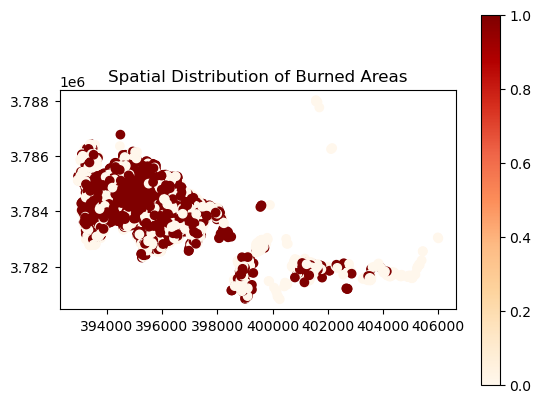

In [12]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Load geospatial data
gdf = gpd.read_file('data/structures_ndvi_points_min_and_mean.gpkg')

# Plot
gdf.plot(column='burned', cmap='OrRd', legend=True)
plt.title('Spatial Distribution of Burned Areas')
plt.show()


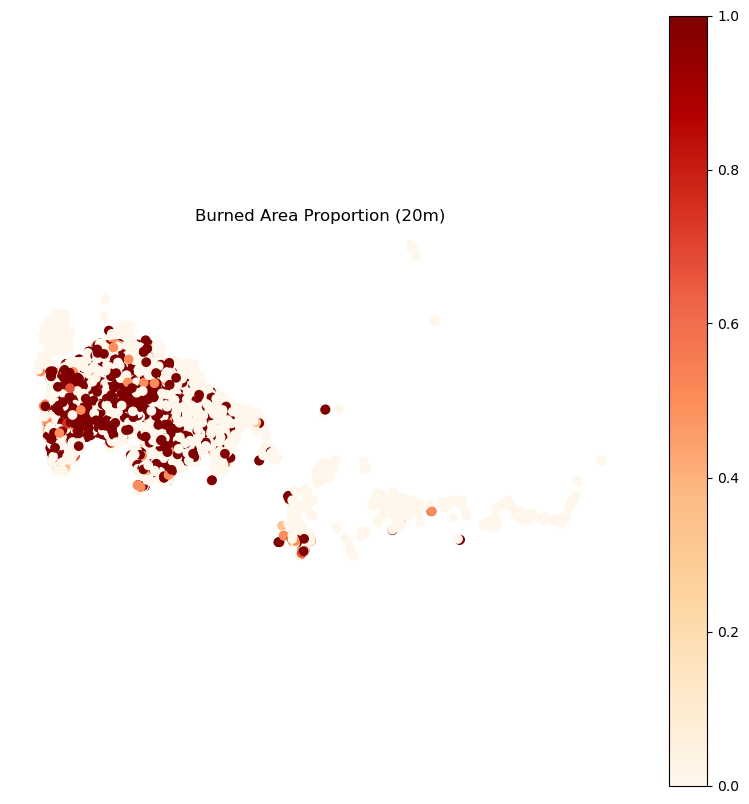

In [28]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Load geospatial data
gdf = gpd.read_file('data/structures_ndvi_points_min_and_mean.gpkg')  # Ensure this file exists

# Plot burned area proportion
gdf.plot(column='burned_proportion_20m', cmap='OrRd', legend=True, figsize=(10, 10))
plt.title('Burned Area Proportion (20m)')
plt.axis('off')
plt.show()


In [37]:
import geopandas as gpd
import folium

# Load the data
gdf = gpd.read_file('data/structures_ndvi_points_min_and_mean.gpkg', layer='points')

# Check CRS
print("Original CRS:", gdf.crs)

# If no CRS is defined, set it manually (likely EPSG:26911 for UTM Zone 11N if it's California)
if gdf.crs is None:
    gdf.set_crs(epsg=26911, inplace=True)  # Update if different

# Convert to WGS84 for Folium
gdf = gdf.to_crs(epsg=4326)

# Create base map
m = folium.Map(location=[34.2, -118.1], zoom_start=12)

# Add points (colored by 'burned' column)
for _, row in gdf.iterrows():
    color = 'red' if row['burned'] == 1 else 'green'
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=3,
        color=color,
        fill=True,
        fill_opacity=0.7
    ).add_to(m)

# Display the map
m

Original CRS: EPSG:26911


In [39]:
import geopandas as gpd
import folium
import matplotlib.cm as cm
import matplotlib.colors as colors

# Load data
gdf = gpd.read_file('data/structures_ndvi_points_min_and_mean.gpkg', layer='points')

# Set CRS if missing and convert to WGS84
if gdf.crs is None:
    gdf.set_crs(epsg=26911, inplace=True)
gdf = gdf.to_crs(epsg=4326)

# Normalize burned proportion values for coloring
burned_col = 'burned_proportion_20m'
norm = colors.Normalize(vmin=gdf[burned_col].min(), vmax=gdf[burned_col].max())
colormap = cm.get_cmap('OrRd')  # Use a red colormap

# Initialize Folium map
m = folium.Map(location=[34.2, -118.1], zoom_start=12)

# Add points with color/size based on burned proportion
for _, row in gdf.iterrows():
    if pd.isna(row[burned_col]):
        continue
    prop = row[burned_col]
    color = colors.to_hex(colormap(norm(prop)))
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=4 + prop * 10,  # scale size with burned proportion
        color=color,
        fill=True,
        fill_opacity=0.7,
        popup=folium.Popup(f"Burned Proportion (20m): {prop:.2f}<br>Burned: {row['burned']}", max_width=250)
    ).add_to(m)

# Add a color scale legend
from branca.colormap import linear
linear_colormap = linear.OrRd_09.scale(gdf[burned_col].min(), gdf[burned_col].max())
linear_colormap.caption = 'Burned Proportion (20m)'
linear_colormap.add_to(m)

# Display
m


C:\Users\as1\AppData\Local\Temp\ipykernel_20200\1086667690.py:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = cm.get_cmap('OrRd')  # Use a red colormap


# Random Forest and XG Boost

Class distribution:
burned
1    6782
0    2778
Name: count, dtype: int64

--- Using Features: ['burned_proportion_20m'] ---
Random Forest:
              precision    recall  f1-score   support

           0       0.67      0.92      0.78      2035
           1       0.87      0.56      0.68      2035

    accuracy                           0.74      4070
   macro avg       0.77      0.74      0.73      4070
weighted avg       0.77      0.74      0.73      4070

XGBoost:
              precision    recall  f1-score   support

           0       0.67      0.92      0.78      2035
           1       0.87      0.56      0.68      2035

    accuracy                           0.74      4070
   macro avg       0.77      0.74      0.73      4070
weighted avg       0.77      0.74      0.73      4070



ExactExplainer explainer: 4071it [01:13, 50.92it/s]                          


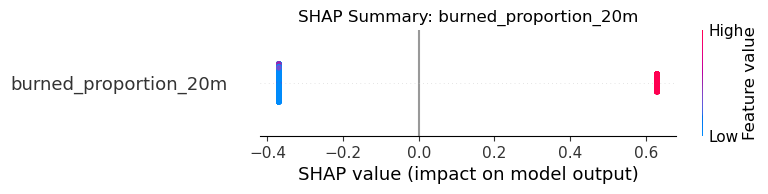


--- Using Features: ['burned_proportion_20m', 'burned_proportion_50m', 'burned_proportion_100m'] ---
Random Forest:
              precision    recall  f1-score   support

           0       0.84      0.83      0.84      2035
           1       0.84      0.84      0.84      2035

    accuracy                           0.84      4070
   macro avg       0.84      0.84      0.84      4070
weighted avg       0.84      0.84      0.84      4070

XGBoost:
              precision    recall  f1-score   support

           0       0.83      0.85      0.84      2035
           1       0.84      0.83      0.84      2035

    accuracy                           0.84      4070
   macro avg       0.84      0.84      0.84      4070
weighted avg       0.84      0.84      0.84      4070



ExactExplainer explainer: 4071it [03:04, 20.99it/s]                          


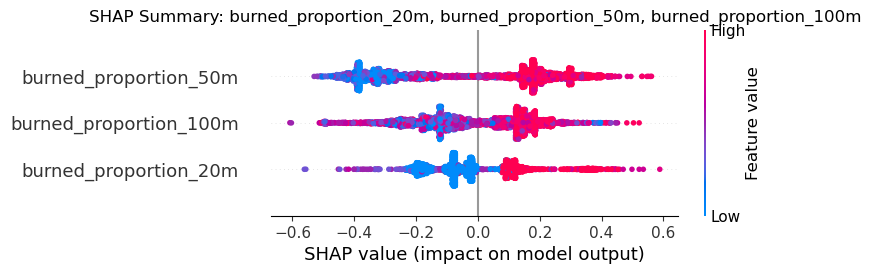


--- Using Features: ['burned_proportion_20m', 'burned_proportion_50m', 'burned_proportion_100m', 'ndvi_min_dist_m', 'ndvi_mean_dist_m'] ---
Random Forest:
              precision    recall  f1-score   support

           0       0.86      0.85      0.86      2034
           1       0.85      0.86      0.86      2033

    accuracy                           0.86      4067
   macro avg       0.86      0.86      0.86      4067
weighted avg       0.86      0.86      0.86      4067

XGBoost:
              precision    recall  f1-score   support

           0       0.87      0.85      0.86      2034
           1       0.85      0.87      0.86      2033

    accuracy                           0.86      4067
   macro avg       0.86      0.86      0.86      4067
weighted avg       0.86      0.86      0.86      4067



ExactExplainer explainer: 4068it [05:33, 11.84it/s]                          


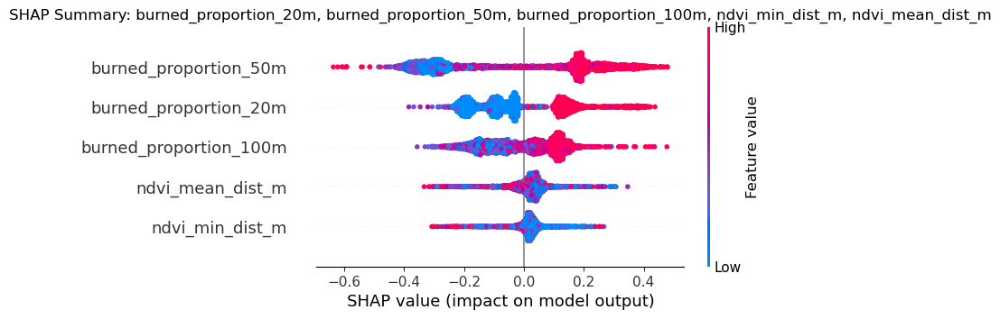


--- Using Features: ['ndvi_min_dist_m'] ---
Random Forest:
              precision    recall  f1-score   support

           0       0.57      0.38      0.45      2034
           1       0.54      0.72      0.61      2033

    accuracy                           0.55      4067
   macro avg       0.55      0.55      0.53      4067
weighted avg       0.55      0.55      0.53      4067

XGBoost:
              precision    recall  f1-score   support

           0       0.57      0.38      0.45      2034
           1       0.53      0.72      0.61      2033

    accuracy                           0.55      4067
   macro avg       0.55      0.55      0.53      4067
weighted avg       0.55      0.55      0.53      4067



ExactExplainer explainer: 4068it [01:13, 46.98it/s]                          


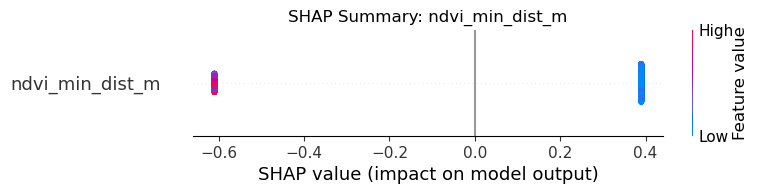


--- Using Features: ['ndvi_mean_dist_m'] ---
Random Forest:
              precision    recall  f1-score   support

           0       0.63      0.61      0.62      2034
           1       0.62      0.64      0.63      2033

    accuracy                           0.63      4067
   macro avg       0.63      0.63      0.63      4067
weighted avg       0.63      0.63      0.63      4067

XGBoost:
              precision    recall  f1-score   support

           0       0.58      0.55      0.56      2034
           1       0.57      0.60      0.58      2033

    accuracy                           0.57      4067
   macro avg       0.57      0.57      0.57      4067
weighted avg       0.57      0.57      0.57      4067



ExactExplainer explainer: 4068it [02:17, 27.18it/s]                          


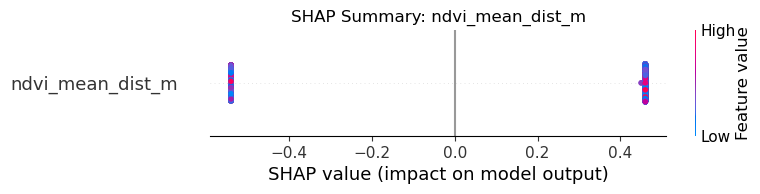


--- Using Features: ['ndvi_min_dist_m', 'ndvi_mean_dist_m'] ---
Random Forest:
              precision    recall  f1-score   support

           0       0.65      0.61      0.63      2034
           1       0.63      0.67      0.65      2033

    accuracy                           0.64      4067
   macro avg       0.64      0.64      0.64      4067
weighted avg       0.64      0.64      0.64      4067

XGBoost:
              precision    recall  f1-score   support

           0       0.61      0.51      0.56      2034
           1       0.58      0.68      0.63      2033

    accuracy                           0.59      4067
   macro avg       0.60      0.59      0.59      4067
weighted avg       0.60      0.59      0.59      4067



ExactExplainer explainer: 4068it [02:45, 22.79it/s]                          


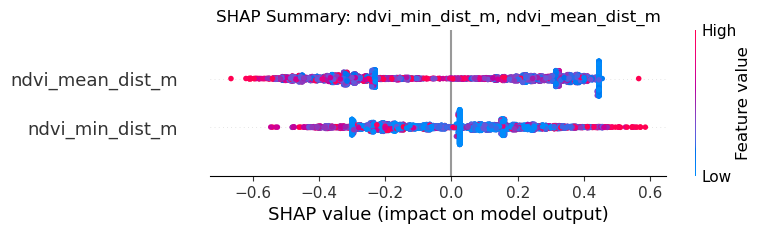

In [22]:
# Import required libraries
import geopandas as gpd
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score
from imblearn.over_sampling import SMOTE
import shap
import matplotlib.pyplot as plt

# === Load Data ===
gpkg_path = "data/structures_ndvi_points_min_and_mean.gpkg"
layer_name = "points"
gdf = gpd.read_file(gpkg_path, layer=layer_name)

# === Check class distribution ===
print("Class distribution:")
print(gdf['burned'].value_counts())

# === Define Feature Sets ===
feature_sets = [
    ["burned_proportion_20m"],
    ["burned_proportion_20m", "burned_proportion_50m", "burned_proportion_100m"],
    ["burned_proportion_20m", "burned_proportion_50m", "burned_proportion_100m", "ndvi_min_dist_m", "ndvi_mean_dist_m"],
    ["ndvi_min_dist_m"],
    ["ndvi_mean_dist_m"],
    ["ndvi_min_dist_m", "ndvi_mean_dist_m"]
]

target = 'burned'

# === Run Models ===
rf_results = []
xgb_results = []

for features in feature_sets:
    print(f"\n--- Using Features: {features} ---")

    data = gdf.dropna(subset=features + [target])
    X = data[features]
    y = data[target]

    # Resample with SMOTE to balance the classes
    smote = SMOTE(random_state=42)
    X_resampled, y_resampled = smote.fit_resample(X, y)

    # Split into training/testing
    X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.3, random_state=42, stratify=y_resampled)

    # === Random Forest with balanced class weights ===
    rf = RandomForestClassifier(n_estimators=100, class_weight='balanced', random_state=42)
    rf.fit(X_train, y_train)
    rf_preds = rf.predict(X_test)

    print("Random Forest:")
    print(classification_report(y_test, rf_preds))
    rf_results.append({
        'Features': ", ".join(features),
        'Accuracy': accuracy_score(y_test, rf_preds)
    })

    # === XGBoost with scale_pos_weight ===
    neg, pos = y_resampled.value_counts()
    scale_pos_weight = neg / pos

    xgb = XGBClassifier(eval_metric='logloss', scale_pos_weight=scale_pos_weight)
    xgb.fit(X_train, y_train)
    xgb_preds = xgb.predict(X_test)

    print("XGBoost:")
    print(classification_report(y_test, xgb_preds))
    xgb_results.append({
        'Features': ", ".join(features),
        'Accuracy': accuracy_score(y_test, xgb_preds)
    })

    # === SHAP Summary Plot ===
    explainer = shap.Explainer(rf.predict, X_train)
    shap_values = explainer(X_test)

    if isinstance(shap_values.values, list):
        shap.summary_plot(shap_values[0], X_test, show=False)
    else:
        shap.summary_plot(shap_values, X_test, show=False)

    plt.title(f"SHAP Summary: {', '.join(features)}")
    plt.show()


Classification Report:

              precision    recall  f1-score   support

           0       0.86      0.85      0.86      2034
           1       0.85      0.86      0.86      2033

    accuracy                           0.86      4067
   macro avg       0.86      0.86      0.86      4067
weighted avg       0.86      0.86      0.86      4067



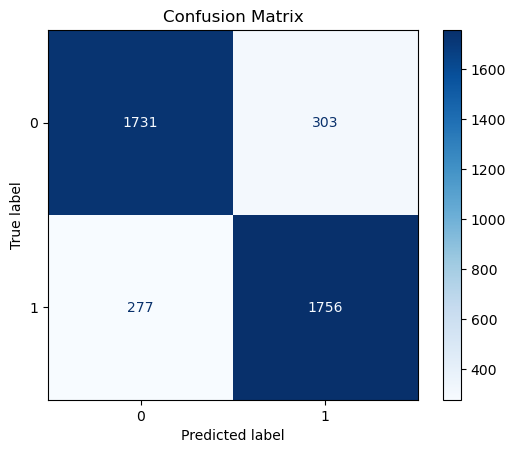

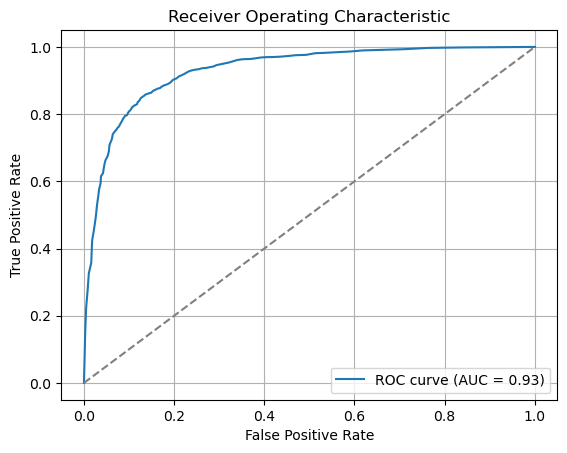

ExactExplainer explainer: 4068it [09:21,  7.23it/s]                                                                    


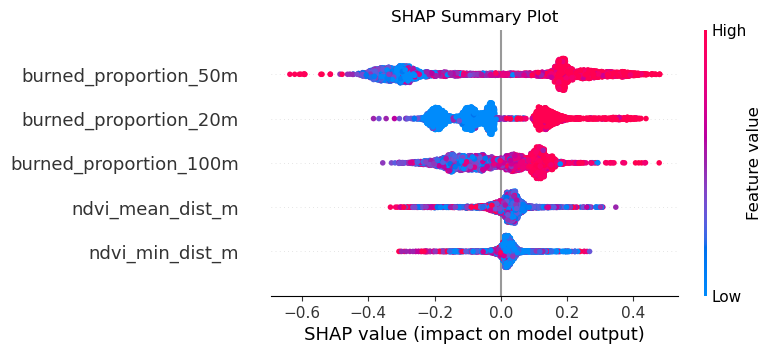

In [6]:

import geopandas as gpd
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, roc_curve, auc
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns
import shap

# === Load Data ===
gpkg_path = "data/structures_ndvi_points_min_and_mean.gpkg"
layer_name = "points"
gdf = gpd.read_file(gpkg_path, layer=layer_name)

# === Features and Target ===
features = [
    "burned_proportion_20m",
    "burned_proportion_50m",
    "burned_proportion_100m",
    "ndvi_min_dist_m",
    "ndvi_mean_dist_m"
]
target = 'burned'

# === Drop missing ===
data = gdf.dropna(subset=features + [target])
X = data[features]
y = data[target]

# === SMOTE Resampling ===
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X, y)

# === Train/Test Split ===
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.3, random_state=42, stratify=y_resampled)

# === Train Model ===
model = RandomForestClassifier(n_estimators=100, class_weight='balanced', random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

# === Evaluation ===
print("\nClassification Report:\n")
print(classification_report(y_test, y_pred))

# === Confusion Matrix ===
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=model.classes_)
disp.plot(cmap='Blues')
plt.title("Confusion Matrix")
plt.show()

# === ROC Curve ===
if hasattr(model, "predict_proba"):
    y_scores = model.predict_proba(X_test)[:, 1]
    fpr, tpr, _ = roc_curve(y_test, y_scores)
    roc_auc = auc(fpr, tpr)

    plt.figure()
    plt.plot(fpr, tpr, label=f"ROC curve (AUC = {roc_auc:.2f})")
    plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("Receiver Operating Characteristic")
    plt.legend()
    plt.grid(True)
    plt.show()

# === SHAP Summary Plot ===
explainer = shap.Explainer(model.predict, X_train)
shap_values = explainer(X_test)
shap.summary_plot(shap_values, X_test, show=False)
plt.title("SHAP Summary Plot")
plt.show()

Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.86      0.86      2044
           1       0.86      0.87      0.86      2023

    accuracy                           0.86      4067
   macro avg       0.86      0.86      0.86      4067
weighted avg       0.86      0.86      0.86      4067



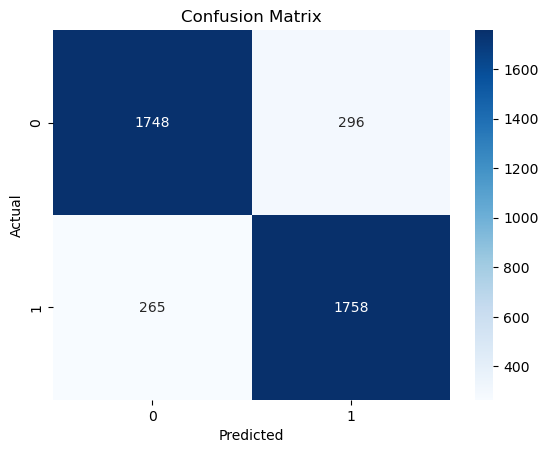

In [18]:
 import pandas as pd
import geopandas as gpd
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns

# Load data
gdf = gpd.read_file("data/structures_ndvi_points_min_and_mean.gpkg", layer="points")

# Define features and target
features = ['burned_proportion_20m', 'burned_proportion_50m', 'burned_proportion_100m', 'ndvi_min_dist_m', 'ndvi_mean_dist_m']
target = 'burned'

# Drop missing values
data = gdf.dropna(subset=features + [target])
X = data[features]
y = data[target]

# Address class imbalance using SMOTE
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X, y)

# Split data
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.3, random_state=42)

# Hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [10, 20, None],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [1, 2],
    'bootstrap': [True, False]
}

rf = RandomForestClassifier(random_state=42)
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, scoring='accuracy')
grid_search.fit(X_train, y_train)

# Best model
best_rf = grid_search.best_estimator_

# Predictions
y_pred = best_rf.predict(X_test)

# Evaluation
print("Classification Report:")
print(classification_report(y_test, y_pred))

# Confusion Matrix
cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()
